In [1]:
import pandas as pd
import numpy as np

# read the data into pandas dataframes
oli_customer = pd.read_csv("olist_customers_dataset.csv")
print("oli_customer lignes:", oli_customer.shape[0], "colonnes:", oli_customer.shape[1])

oli_ord_data = pd.read_csv("olist_orders_dataset.csv")
print("oli_ord_data lignes:", oli_ord_data.shape[0], "colonnes:", oli_ord_data.shape[1])


oli_customer lignes: 99441 colonnes: 5
oli_ord_data lignes: 99441 colonnes: 8


In [2]:
# merge the "customers" csv file data and the "central orders" csv file data
merged_custocent = pd.merge(left = oli_customer, right = oli_ord_data, on = "customer_id")

# how many orders per customers?
merged_custocent['customer_unique_id'].value_counts()


8d50f5eadf50201ccdcedfb9e2ac8455    17
3e43e6105506432c953e165fb2acf44c     9
6469f99c1f9dfae7733b25662e7f1782     7
ca77025e7201e3b30c44b472ff346268     7
1b6c7548a2a1f9037c1fd3ddfed95f33     7
                                    ..
e63a75e5f4e4910e278dcb39c92affd2     1
e6b4538b7f8624277a276ffe0867f549     1
652452e3f6467b9df7e3b65399262956     1
8872b784e55aac02ec982170ed7f25ce     1
b39adb9e36b90d48aca89f2dc0d6d9b5     1
Name: customer_unique_id, Length: 96096, dtype: int64

In [3]:
def vals_manquantes(data):
    """ 
    Function to get informations about missing values

    Parameters:
    data (pandas dataframe): Data from which we want to get missing values information

    Returns:
    nulls_df: Dataframe that contains the number of missing values and the percentage of them in the 
              corresponding column
    """
    
    # number of missing values for each column  
    missing_data = data.isnull().sum()
    
    # percentage of missing values
    null_counts_pct = missing_data / data.shape[0] * 100
    # easier to visualise together (the total number and percentage):
    nulls_df = pd.DataFrame({'null_counts': missing_data, 'null_pct': null_counts_pct})
    
    # sort by percentage values
    nulls_df = nulls_df.sort_values(by = "null_pct")
    
    return nulls_df


In [4]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

def make_heatmap(data, rot_degr, leng, height):
    """ 
    Function to get heatmap showing missing values.

    Parameters:
    data (pandas dataframe): Data from which we want to get missing values information
    rot_degr: rotation of the x axis labels
    leng: length of figure
    height: height of figure

    Returns:
    Heatmap figure
    """

    fig, axes = plt.subplots(figsize=[leng,height]) 
    sns_plot = sns.heatmap(data.isnull(), cbar = False)
    sns.set(font_scale = 1)  
    sns_plot.set_title("Heatmap des Valeurs Manquantes", fontsize = 15)
    plt.xticks(rotation = rot_degr, fontsize = 12)
    plt.yticks(rotation = 0, fontsize = 13)
    # the missing values are shown in beige
    fig = sns_plot.get_figure()
    plt.show()

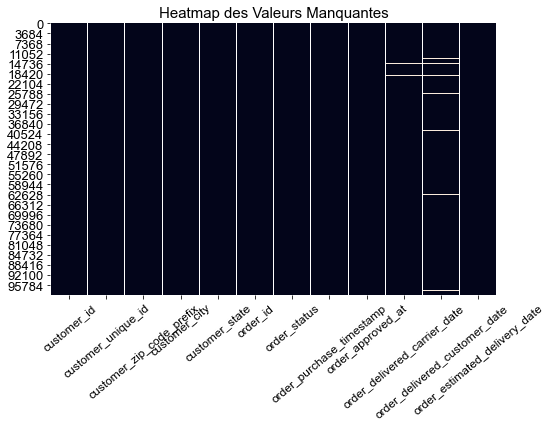

In [5]:
make_heatmap(merged_custocent, 40, 8, 5)

In [6]:
vals_manquantes(merged_custocent)

,null_counts,null_pct
customer_id,0,0.000000
customer_unique_id,0,0.000000
customer_zip_code_prefix,0,0.000000
customer_city,0,0.000000
customer_state,0,0.000000
order_id,0,0.000000
order_status,0,0.000000
order_purchase_timestamp,0,0.000000
order_estimated_delivery_date,0,0.000000
order_approved_at,160,0.160899


In [7]:
merged_custocent[merged_custocent["order_status"] == "delivered"]

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05 00:00:00
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06 00:00:00
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13 00:00:00
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10 00:00:00
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...
99436,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,3937,sao paulo,SP,6760e20addcf0121e9d58f2f1ff14298,delivered,2018-04-07 15:48:17,2018-04-07 16:08:45,2018-04-11 02:08:36,2018-04-13 20:06:37,2018-04-25 00:00:00
99437,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,6764,taboao da serra,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,2018-04-04 08:20:22,2018-04-04 08:35:12,2018-04-05 18:42:35,2018-04-11 18:54:45,2018-04-20 00:00:00
99438,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,CE,fed4434add09a6f332ea398efd656a5c,delivered,2018-04-08 20:11:50,2018-04-08 20:30:03,2018-04-09 17:52:17,2018-05-09 19:03:15,2018-05-02 00:00:00
99439,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS,e31ec91cea1ecf97797787471f98a8c2,delivered,2017-11-03 21:08:33,2017-11-03 21:31:20,2017-11-06 18:24:41,2017-11-16 19:58:39,2017-12-05 00:00:00


In [8]:
merged_custocent[merged_custocent["order_status"] != "delivered"]

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
46,f34a6e874087ec1f0e3dab9fdf659c5d,233896de79986082f1f479f1f85281cb,38300,ituiutaba,MG,6e98de3a85c84ead6689189b825d35b5,canceled,2018-03-15 10:07:02,2018-03-15 10:29:33,NaN,NaN,2018-04-09 00:00:00
47,c132855c926907970dcf6f2bf0b33a24,a8ae36a2bb6c2bbc3b5d62ede131c9ef,18740,taquarituba,SP,b5172d4a722c0ebb34c29bbbb7a3cb42,invoiced,2018-04-17 13:14:13,2018-04-18 05:31:51,NaN,NaN,2018-05-24 00:00:00
70,4c7241af24b5344cb01fe687643de4fe,b157c176c3fe04914fde33f2dc8b878a,60336,fortaleza,CE,ad380680e87dea0f2abf5cd5bace626c,shipped,2018-01-21 15:54:02,2018-01-22 13:52:41,2018-01-24 18:26:40,NaN,2018-02-20 00:00:00
79,f6529ffebe6b3440d45d89604a4239ac,e5dbefdfdf3eff75c8e6cd655f128279,26272,nova iguacu,RJ,cc07a8fdd3a8e94d683c8142a117dbc1,shipped,2018-01-11 17:11:11,2018-01-12 17:49:45,2018-01-17 16:56:32,NaN,2018-02-09 00:00:00
100,ae76a4650235ab18764708174f1da31e,2b6082a140c439e2df870c85b0aa5e88,2983,sao paulo,SP,4c33ec562d9dc5655e160913aa86eb53,shipped,2017-08-11 23:47:48,2017-08-12 00:03:51,2017-08-14 13:24:58,NaN,2017-09-11 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...
99248,6a65b5d6d4f4c9dfda93798cf014ee47,5b66137675c164a7df3b639bf1e86134,3959,sao paulo,SP,8c0dd54ff6a273a02de12494c6bf299f,shipped,2018-07-17 22:35:46,2018-07-18 21:22:25,2018-07-30 09:00:00,NaN,2018-08-02 00:00:00
99280,9ce70b8dafe76524f3d5e5e68cbf29f5,6edd9e4a22b7ab02db2a87f13bfd2d2a,14093,ribeirao preto,SP,e5e59fe47003046e2ed48ebb641564b2,shipped,2018-04-27 13:52:12,2018-04-27 14:09:00,2018-05-02 14:39:00,NaN,2018-05-23 00:00:00
99288,2a6fc1968c4a29c9c258bb1994afbc7f,205a1c797b2c6e626d560900a3ebde6b,27210,volta redonda,RJ,12d9fe1a3efa51a7fae337cba819adc1,shipped,2017-02-08 13:07:19,2017-02-09 02:50:42,2017-02-09 10:56:46,NaN,2017-03-17 00:00:00
99351,f83083fcbc51d12f8279b5713c2d4b4d,0465f164e35aba70f70e911b252513a9,77807,araguaina,TO,67384817c871ae183b24f9a0a6eb9bbc,shipped,2018-01-25 12:12:37,2018-01-25 12:31:27,2018-01-26 17:49:00,NaN,2018-03-01 00:00:00


In [9]:
# keep only the data points for which the order did get delivered 
merged_custocent = merged_custocent[merged_custocent["order_status"] == "delivered"]

# delete the only order for september 2016 (all others start in october 2016)
indexNames = merged_custocent[merged_custocent["order_id"] == "bfbd0f9bdef84302105ad712db648a6c"].index
merged_custocent.drop(indexNames, inplace = True)

print("merged_custocent lignes:", merged_custocent.shape[0], "colonnes:", merged_custocent.shape[1])

merged_custocent lignes: 96477 colonnes: 12


In [10]:
vals_manquantes(merged_custocent)

,null_counts,null_pct
customer_id,0,0.000000
customer_unique_id,0,0.000000
customer_zip_code_prefix,0,0.000000
customer_city,0,0.000000
customer_state,0,0.000000
order_id,0,0.000000
order_status,0,0.000000
order_purchase_timestamp,0,0.000000
order_estimated_delivery_date,0,0.000000
order_delivered_carrier_date,2,0.002073


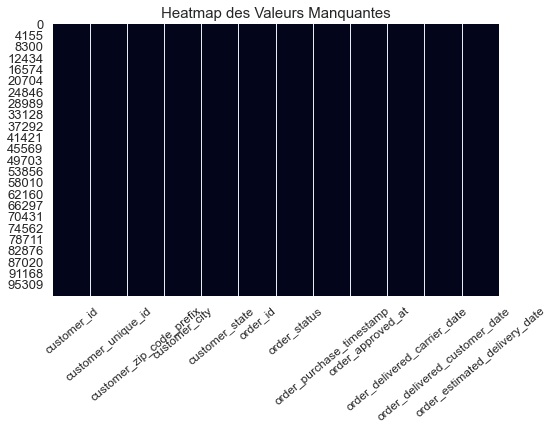

In [11]:
make_heatmap(merged_custocent, 40, 8, 5)

In [12]:
# delete the data points that have missing values
subset = ["order_delivered_customer_date", "order_approved_at",
          "order_delivered_carrier_date"]
merged_custocent = merged_custocent.dropna(subset = subset).copy()

In [13]:
vals_manquantes(merged_custocent)

,null_counts,null_pct
customer_id,0,0.0
customer_unique_id,0,0.0
customer_zip_code_prefix,0,0.0
customer_city,0,0.0
customer_state,0,0.0
order_id,0,0.0
order_status,0,0.0
order_purchase_timestamp,0,0.0
order_approved_at,0,0.0
order_delivered_carrier_date,0,0.0


In [14]:
import datetime as dt

print(type(merged_custocent["order_purchase_timestamp"]))

# convert the dates into datetime
merged_custocent["order_purchase_timestamp"] = pd.to_datetime(merged_custocent["order_purchase_timestamp"], 
                                                              format = "%Y-%m-%d %H:%M:%S")
merged_custocent["order_approved_at"] = pd.to_datetime(merged_custocent["order_approved_at"], 
                                                       format = "%Y-%m-%d %H:%M:%S")
merged_custocent["order_delivered_customer_date"] = pd.to_datetime\
                                                         (merged_custocent["order_delivered_customer_date"], 
                                                              format = "%Y-%m-%d %H:%M:%S")
merged_custocent["order_estimated_delivery_date"] = pd.to_datetime\
                                                        (merged_custocent["order_estimated_delivery_date"], 
                                                                   format = "%Y-%m-%d %H:%M:%S")

merged_custocent["order_approved_at"].max()

<class 'pandas.core.series.Series'>


Timestamp('2018-08-29 15:10:26')

In [15]:
len(merged_custocent['customer_state'].unique())

27

In [16]:
# create a new column, customer_region, according to the customer state
merged_custocent["customer_region"] = "NORD"

merged_custocent.customer_region[(merged_custocent.customer_state == "SP") 
                                 | (merged_custocent.customer_state == "RJ")
                                 | (merged_custocent.customer_state == "MG") 
                                 | (merged_custocent.customer_state == "ES")] = "SUD EST"
                        
merged_custocent.customer_region[(merged_custocent.customer_state == "PR")
                                 | (merged_custocent.customer_state == "SC") 
                                 | (merged_custocent.customer_state == "RS")] = "SUD"

merged_custocent.customer_region[(merged_custocent.customer_state == "MT") 
                                 | (merged_custocent.customer_state == "GO")
                                 | (merged_custocent.customer_state == "DF")
                                 | (merged_custocent.customer_state == "MS")] = "CENTRE- OUEST"

merged_custocent.value_counts('customer_region')

<ipython-input-16-75798adfceba>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_custocent.customer_region[(merged_custocent.customer_state == "SP")
<ipython-input-16-75798adfceba>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_custocent.customer_region[(merged_custocent.customer_state == "PR")
<ipython-input-16-75798adfceba>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_custocent.customer_region[(merged_cust

customer_region
SUD EST          66181
SUD              13811
NORD             10838
CENTRE- OUEST     5624
dtype: int64

In [17]:
merged_custocent.columns = ['customer_id', 'customer_unique_id', 
                            'geolocation_zip_code_prefix',
                            'customer_city', 'customer_state', 'order_id', 'order_status',
                            'order_purchase_timestamp', 'order_approved_at',
                            'order_delivered_carrier_date', 'order_delivered_customer_date',
                            'order_estimated_delivery_date', 
                            'customer_region']

In [18]:
# drop the columns that are no longer relevant to us
merged_custocent_reg = merged_custocent.drop(['customer_state'], axis = 1).copy()

In [19]:
vals_manquantes(merged_custocent_reg)

,null_counts,null_pct
customer_id,0,0.0
customer_unique_id,0,0.0
geolocation_zip_code_prefix,0,0.0
customer_city,0,0.0
order_id,0,0.0
order_status,0,0.0
order_purchase_timestamp,0,0.0
order_approved_at,0,0.0
order_delivered_carrier_date,0,0.0
order_delivered_customer_date,0,0.0


Geolocation Exploration

In [20]:
geoloc = pd.read_csv('olist_geolocation_dataset.csv')
print("geoloc lignes:", geoloc.shape[0], "colonnes: ", geoloc.shape[1])

geoloc lignes: 1000163 colonnes:  5


In [21]:
vals_manquantes(geoloc)

,null_counts,null_pct
geolocation_zip_code_prefix,0,0.0
geolocation_lat,0,0.0
geolocation_lng,0,0.0
geolocation_city,0,0.0
geolocation_state,0,0.0


In [22]:
# check the duplicates
dups_loc = geoloc[geoloc.duplicated("geolocation_zip_code_prefix", keep = False)]
print("dups_loc lignes:", dups_loc.shape[0], "colonnes: ", dups_loc.shape[1])

dups_loc lignes: 999120 colonnes:  5


In [23]:
# use the mode as the value that will be kept for duplicated zip codes
main_lat = geoloc.groupby("geolocation_zip_code_prefix")["geolocation_lat"].agg(
    lambda x: pd.Series.mode(x)[0])

main_lat = pd.DataFrame(main_lat)
main_lat.columns = ["geoloc_main_latitude"]
main_lat

geoloc = pd.merge(left = geoloc.copy(), right = main_lat.copy(), how = "outer", 
                  on = "geolocation_zip_code_prefix")


In [24]:
main_longt = geoloc.groupby("geolocation_zip_code_prefix")["geolocation_lng"].agg(
                lambda x: pd.Series.mode(x)[0])

main_longt = pd.DataFrame(main_longt)
main_longt.columns = ["geoloc_main_longitude"]
main_longt

geoloc = pd.merge(left = geoloc.copy(), right = main_longt.copy(), 
                  how = "outer", on = "geolocation_zip_code_prefix")


In [25]:
# keep only one data point per zip code
geoloc_nodups = geoloc.drop_duplicates('geolocation_zip_code_prefix', keep = 'first').copy()
print("geoloc_nodups lignes:", geoloc_nodups.shape[0], "colonnes: ", geoloc_nodups.shape[1])

geoloc_nodups lignes: 19015 colonnes:  7


In [26]:
geoloc_nodups = geoloc_nodups[['geolocation_zip_code_prefix', 'geoloc_main_latitude','geoloc_main_longitude']]
geoloc_nodups

,geolocation_zip_code_prefix,geoloc_main_latitude,geoloc_main_longitude
0,1037,-23.545187,-46.637855
26,1046,-23.546081,-46.644820
167,1041,-23.543496,-46.640524
192,1035,-23.540984,-46.642569
231,1012,-23.547119,-46.634881
...,...,...,...
1000114,99955,-28.132189,-52.147129
1000126,99970,-28.343273,-51.873734
1000147,99910,-27.861309,-52.084405
1000153,99920,-27.860664,-52.304946


In [27]:
vals_manquantes(geoloc_nodups)

,null_counts,null_pct
geolocation_zip_code_prefix,0,0.0
geoloc_main_latitude,0,0.0
geoloc_main_longitude,0,0.0


Traitement pour les vendeurs

In [28]:
oli_sellers = pd.read_csv("olist_sellers_dataset.csv")
print("oli_sellers lignes:", oli_sellers.shape[0], "colonnes: ", oli_sellers.shape[1])

oli_sellers lignes: 3095 colonnes:  4


In [29]:
vals_manquantes(oli_sellers)

,null_counts,null_pct
seller_id,0,0.0
seller_zip_code_prefix,0,0.0
seller_city,0,0.0
seller_state,0,0.0


In [30]:
oli_sellers.value_counts('seller_state')

seller_state
SP    1849
PR     349
MG     244
SC     190
RJ     171
RS     129
GO      40
DF      30
ES      23
BA      19
CE      13
PE       9
PB       6
MS       5
RN       5
MT       4
RO       2
SE       2
AC       1
PI       1
AM       1
MA       1
PA       1
dtype: int64

In [31]:
# just like for customers, get the region of each seller

oli_sellers["region"] = "NORD"

oli_sellers.region[(oli_sellers.seller_state == "SP") 
                        | (oli_sellers.seller_state == "RJ")
                        | (oli_sellers.seller_state == "MG") 
                        | (oli_sellers.seller_state == "ES")] = "SUD EST"
                        
oli_sellers.region[(oli_sellers.seller_state == "PR")
                        | (oli_sellers.seller_state == "SC") 
                        | (oli_sellers.seller_state == "RS")] = "SUD"

oli_sellers.region[(oli_sellers.seller_state == "MT") 
                        | (oli_sellers.seller_state == "GO")
                        | (oli_sellers.seller_state == "DF")
                        | (oli_sellers.seller_state == "MS")] = "CENTRE - OUEST"

oli_sellers.value_counts('region')

<ipython-input-31-bc34da24a4a3>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  oli_sellers.region[(oli_sellers.seller_state == "SP")
<ipython-input-31-bc34da24a4a3>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  oli_sellers.region[(oli_sellers.seller_state == "PR")
<ipython-input-31-bc34da24a4a3>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  oli_sellers.region[(oli_sellers.seller_state == "MT")


region
SUD EST           2287
SUD                668
CENTRE - OUEST      79
NORD                61
dtype: int64

In [32]:
oli_sellers.columns = ['seller_id', 
                       'geolocation_zip_code_prefix', 
                       'seller_city', 'seller_state',
                       'region']

In [33]:
oli_sellers = oli_sellers.drop(['seller_state'], axis = 1).copy()

In [34]:
oli_sellers = pd.merge(left = oli_sellers.copy(), right = geoloc_nodups.copy(), 
                       how = "left", on = "geolocation_zip_code_prefix")
oli_sellers

,seller_id,geolocation_zip_code_prefix,seller_city,region,geoloc_main_latitude,geoloc_main_longitude
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SUD EST,-22.897888,-47.064010
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SUD EST,-22.395575,-46.948334
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,SUD EST,-22.908905,-43.178267
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SUD EST,-23.655269,-46.612199
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SUD EST,-22.963618,-46.538464
...,...,...,...,...,...,...
3090,98dddbc4601dd4443ca174359b237166,87111,sarandi,SUD,-23.456431,-51.872536
3091,f8201cab383e484733266d1906e2fdfa,88137,palhoca,SUD,-27.626211,-48.673749
3092,74871d19219c7d518d0090283e03c137,4650,sao paulo,SUD EST,-23.660238,-46.678789
3093,e603cf3fec55f8697c9059638d6c8eb5,96080,pelotas,SUD,-31.764283,-52.329698


In [35]:
oli_sellers.columns = ['seller_id', 'seller_zip_code_prefix', 'seller_city', 'seller_region',
                       'seller_main_latitude', 'seller_main_longitude']

In [36]:
vals_manquantes(oli_sellers)

,null_counts,null_pct
seller_id,0,0.000000
seller_zip_code_prefix,0,0.000000
seller_city,0,0.000000
seller_region,0,0.000000
seller_main_latitude,7,0.226171
seller_main_longitude,7,0.226171


In [37]:
oli_sellers.sort_values(by = "seller_main_longitude").to_csv('test_seller_missing.csv')

In [38]:
oli_sellers = oli_sellers.sort_values(by = "seller_zip_code_prefix").fillna(method = "ffill", axis = 0)
vals_manquantes(oli_sellers)

,null_counts,null_pct
seller_id,0,0.0
seller_zip_code_prefix,0,0.0
seller_city,0,0.0
seller_region,0,0.0
seller_main_latitude,0,0.0
seller_main_longitude,0,0.0


In [39]:
oli_sellers.sort_values(by = "seller_zip_code_prefix").to_csv('test_filled_sellers.csv')

Order Items / Products: Exploration

In [40]:
# read the csvs to do with the products and order items
oli_ord_items = pd.read_csv("olist_order_items_dataset.csv")
print("oli_ord_items lignes:", oli_ord_items.shape[0], "colonnes:", oli_ord_items.shape[1])


oli_ord_prod = pd.read_csv("olist_products_dataset.csv")
print("oli_ord_prod lignes:", oli_ord_prod.shape[0], "colonnes:", oli_ord_prod.shape[1])

oli_ord_items lignes: 112650 colonnes: 7
oli_ord_prod lignes: 32951 colonnes: 9


In [41]:
# merge the two dataframes and merge them with the sellers dataframe
prod_order = pd.merge(left = oli_ord_items, right = oli_ord_prod, how = "outer", on = "product_id")
merge_prod_seller = pd.merge(left = prod_order, right = oli_sellers, how = "outer", on = "seller_id")

print("merge_prod_seller lignes:", merge_prod_seller.shape[0], "colonnes:", merge_prod_seller.shape[1])

merge_prod_seller lignes: 112650 colonnes: 20


In [42]:
vals_manquantes(merge_prod_seller)

,null_counts,null_pct
order_id,0,0.000000
seller_region,0,0.000000
seller_city,0,0.000000
seller_zip_code_prefix,0,0.000000
seller_main_latitude,0,0.000000
freight_value,0,0.000000
seller_main_longitude,0,0.000000
shipping_limit_date,0,0.000000
seller_id,0,0.000000
product_id,0,0.000000


In [43]:
merge_prod_seller["product_category_name"].value_counts()

cama_mesa_banho                  11115
beleza_saude                      9670
esporte_lazer                     8641
moveis_decoracao                  8334
informatica_acessorios            7827
                                 ...  
cds_dvds_musicais                   14
la_cuisine                          14
pc_gamer                             9
fashion_roupa_infanto_juvenil        8
seguros_e_servicos                   2
Name: product_category_name, Length: 73, dtype: int64

In [44]:
homeware_household = ["cama_mesa_banho", 
                      "casa_conforto",
                      "climatizacao",
                      "moveis_sala",
                      "moveis_quarto",
                      "moveis_decoracao", 
                      "moveis_cozinha_area_de_servico_jantar_e_jardim",
                      "portateis_casa_forno_e_cafe",
                      "la_cuisine", 
                      "ferramentas_jardim",
                      "casa_construcao",
                      "eletroportateis",
                      "utilidades_domesticas", 
                      "eletrodomesticos",
                      "eletrodomesticos_2",
                      "moveis_escritorio"]  

sports_leisure = ["esporte_lazer", "fashion_esporte"]

technology = ["informatica_acessorios", "telefonia",
              "pcs",
              "tablets_impressao_imagem",
              "eletronicos", "telefonia_fixa"]

health_beauty = ["beleza_saude", "perfumaria"]


In [45]:
merge_prod_seller["product_cat"] = "other"

merge_prod_seller.product_cat[merge_prod_seller["product_category_name"].\
                              isin(homeware_household)] = "homeware_household"

merge_prod_seller.product_cat[merge_prod_seller["product_category_name"].isin(health_beauty)] = "health_beauty"

merge_prod_seller.product_cat[merge_prod_seller["product_category_name"].isin(sports_leisure)] = "sports_leisure"

merge_prod_seller.product_cat[merge_prod_seller["product_category_name"].isin(technology)] = "technology"

merge_prod_seller["product_cat"].value_counts()


<ipython-input-45-4d5c98104680>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merge_prod_seller.product_cat[merge_prod_seller["product_category_name"].\
<ipython-input-45-4d5c98104680>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merge_prod_seller.product_cat[merge_prod_seller["product_category_name"].isin(health_beauty)] = "health_beauty"
<ipython-input-45-4d5c98104680>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merge_pro

other                 38744
homeware_household    36457
technology            15689
health_beauty         13089
sports_leisure         8671
Name: product_cat, dtype: int64

In [46]:
merge_prod_seller = merge_prod_seller.drop(['product_name_lenght', 
                                            'product_description_lenght',
                                            'product_photos_qty',
                                            'product_weight_g',
                                            'product_length_cm', 'product_height_cm',
                                            'product_width_cm',], axis = 1).copy()

In [47]:
merge_prod_seller["order_id"].value_counts()

8272b63d03f5f79c56e9e4120aec44ef    21
ab14fdcfbe524636d65ee38360e22ce8    20
1b15974a0141d54e36626dca3fdc731a    20
9ef13efd6949e4573a18964dd1bbe7f5    15
428a2f660dc84138d969ccd69a0ab6d5    15
                                    ..
557301323d2ab3151c0e56b06aafd2bc     1
500ae586f3dab7aba8557a29f0073de4     1
bf5b783279dc70c35854c1df2ec850c4     1
35e3eedfd9714f8e56fee1b037cbb5d6     1
2613fb342bec59126f9c5180a5bc95ec     1
Name: order_id, Length: 98666, dtype: int64

In [48]:
# most frequent product category, per order
groupedprodcats = merge_prod_seller.groupby("order_id")["product_cat"].agg(
                    lambda x: pd.Series.mode(x)[0])

groupedprodcats = pd.DataFrame(groupedprodcats)
groupedprodcats.columns = ["frequent_prod_cat"]
groupedprodcats

,frequent_prod_cat
order_id,
00010242fe8c5a6d1ba2dd792cb16214,other
00018f77f2f0320c557190d7a144bdd3,other
000229ec398224ef6ca0657da4fc703e,homeware_household
00024acbcdf0a6daa1e931b038114c75,health_beauty
00042b26cf59d7ce69dfabb4e55b4fd9,homeware_household
...,...
fffc94f6ce00a00581880bf54a75a037,homeware_household
fffcd46ef2263f404302a634eb57f7eb,technology
fffce4705a9662cd70adb13d4a31832d,sports_leisure


In [49]:
merge_prod_seller = pd.merge(left = merge_prod_seller.copy(), right = groupedprodcats.copy(), 
                             how = "outer", on = "order_id")

# number of items per order 
merge_prod_seller["nb_of_items_per_order"] = merge_prod_seller.groupby("order_id")["order_item_id"].transform('max')

# total seller price per order
merge_prod_seller["total_seller_ord_price"] = merge_prod_seller.groupby("order_id")["price"].transform('sum')


In [50]:
# freight price per order
merge_prod_seller["seller_summed_freight_value"] = merge_prod_seller.groupby("order_id")["freight_value"]\
                                                      .transform('sum')

# total order price 
merge_prod_seller["seller_summedfreight_plus_price"] = (merge_prod_seller["seller_summed_freight_value"] + 
                                                        merge_prod_seller["total_seller_ord_price"])

In [51]:
merge_prod_seller = merge_prod_seller.drop_duplicates("order_id", keep = 'first')
merge_prod_seller = merge_prod_seller.drop(["order_item_id", "product_cat", "price"], axis= 1)

In [52]:
print("merge_prod_seller lignes:", merge_prod_seller.shape[0], "colonnes: ", merge_prod_seller.shape[1])

merge_prod_seller lignes: 98666 colonnes:  16


In [53]:
vals_manquantes(merge_prod_seller)

,null_counts,null_pct
order_id,0,0.000000
product_id,0,0.000000
seller_id,0,0.000000
shipping_limit_date,0,0.000000
freight_value,0,0.000000
seller_zip_code_prefix,0,0.000000
seller_city,0,0.000000
seller_region,0,0.000000
seller_main_latitude,0,0.000000
seller_main_longitude,0,0.000000


Merge between the central order dataframe and the merged_products_sellers dataframe

In [54]:
print(merge_prod_seller.shape)
print(merged_custocent_reg.shape)

(98666, 16)
(96454, 12)


In [55]:
vals_manquantes(merged_custocent_reg)

,null_counts,null_pct
customer_id,0,0.0
customer_unique_id,0,0.0
geolocation_zip_code_prefix,0,0.0
customer_city,0,0.0
order_id,0,0.0
order_status,0,0.0
order_purchase_timestamp,0,0.0
order_approved_at,0,0.0
order_delivered_carrier_date,0,0.0
order_delivered_customer_date,0,0.0


In [56]:
merged_custocent_reg = pd.merge(left = merged_custocent_reg.copy(), right = geoloc_nodups.copy(), 
                                how = "left", on = "geolocation_zip_code_prefix")

In [57]:
merged_custocent_reg.columns

Index(['customer_id', 'customer_unique_id', 'geolocation_zip_code_prefix',
       'customer_city', 'order_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_region', 'geoloc_main_latitude', 'geoloc_main_longitude'],
      dtype='object')

In [58]:
merged_custocent_reg.columns = ['customer_id', 'customer_unique_id', 
                                'customer_zip_code_prefix', 'customer_city',
                                'order_id', 'order_status', 'order_purchase_timestamp',
                                'order_approved_at', 
                                'order_delivered_carrier_date', 'order_delivered_customer_date', 
                                'order_estimated_delivery_date',
                                'customer_region', 'customer_main_latitude', 'customer_main_longitude']

In [59]:
vals_manquantes(merged_custocent_reg)

,null_counts,null_pct
customer_id,0,0.000000
customer_unique_id,0,0.000000
customer_zip_code_prefix,0,0.000000
customer_city,0,0.000000
order_id,0,0.000000
order_status,0,0.000000
order_purchase_timestamp,0,0.000000
order_approved_at,0,0.000000
order_delivered_carrier_date,0,0.000000
order_delivered_customer_date,0,0.000000


In [60]:
merged_custocent_reg.sort_values(by = "customer_main_longitude").to_csv('test_customer_missing.csv')

In [61]:
merged_custocent_reg = merged_custocent_reg.sort_values(by = "customer_zip_code_prefix").fillna(method = "ffill",
                                                                                                axis = 0)
vals_manquantes(merged_custocent_reg)

,null_counts,null_pct
customer_id,0,0.0
customer_unique_id,0,0.0
customer_zip_code_prefix,0,0.0
customer_city,0,0.0
order_id,0,0.0
order_status,0,0.0
order_purchase_timestamp,0,0.0
order_approved_at,0,0.0
order_delivered_carrier_date,0,0.0
order_delivered_customer_date,0,0.0


In [62]:
# manually impute some values that are errors

merged_custocent_reg.customer_main_latitude[merged_custocent_reg["customer_city"] == "ilha dos valadares"]\
                                                                                            = -25.58487215050158

merged_custocent_reg.customer_main_longitude[merged_custocent_reg["customer_city"] == "ilha dos valadares"] \
                                                                                        = -48.5775723218963

<ipython-input-62-68cc3d65fc06>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_custocent_reg.customer_main_latitude[merged_custocent_reg["customer_city"] == "ilha dos valadares"]\
<ipython-input-62-68cc3d65fc06>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_custocent_reg.customer_main_longitude[merged_custocent_reg["customer_city"] == "ilha dos valadares"] \


In [63]:
merged_custocent_reg.customer_main_latitude[merged_custocent_reg["customer_city"] == "santo antonio do canaa"] \
                                                                                        = -19.93342700306017

merged_custocent_reg.customer_main_longitude[merged_custocent_reg["customer_city"] == "santo antonio do canaa"] \
                                                                                            = -40.60627748087389

<ipython-input-63-86628395bb12>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_custocent_reg.customer_main_latitude[merged_custocent_reg["customer_city"] == "santo antonio do canaa"] \
<ipython-input-63-86628395bb12>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_custocent_reg.customer_main_longitude[merged_custocent_reg["customer_city"] == "santo antonio do canaa"] \


In [64]:
merged_custocent_reg.customer_main_latitude[merged_custocent_reg["customer_city"] == "porto trombetas"] \
                                                                                        = -2.0070910891578224

merged_custocent_reg.customer_main_longitude[merged_custocent_reg["customer_city"] == "porto trombetas"] \
                                                                                            = -54.08589045605613

<ipython-input-64-7c02fc490386>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_custocent_reg.customer_main_latitude[merged_custocent_reg["customer_city"] == "porto trombetas"] \
<ipython-input-64-7c02fc490386>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_custocent_reg.customer_main_longitude[merged_custocent_reg["customer_city"] == "porto trombetas"] \


In [65]:
merged_custocent_reg.sort_values(by = "customer_zip_code_prefix").to_csv('test_customer_filled.csv')

In [66]:
merge_cust_prods = pd.merge(left = merged_custocent_reg.copy(), right = merge_prod_seller.copy(),
                            how = "inner", on = "order_id")
print(merge_cust_prods.shape)

(96454, 29)


In [67]:
vals_manquantes(merge_cust_prods)

,null_counts,null_pct
customer_id,0,0.000000
total_seller_ord_price,0,0.000000
nb_of_items_per_order,0,0.000000
frequent_prod_cat,0,0.000000
seller_main_longitude,0,0.000000
seller_main_latitude,0,0.000000
seller_region,0,0.000000
seller_city,0,0.000000
seller_zip_code_prefix,0,0.000000
freight_value,0,0.000000


Payment Exploration

In [68]:
oli_ord_payment = pd.read_csv("olist_order_payments_dataset.csv")
print("oli_ord_payment lignes:", oli_ord_payment.shape[0], "colonnes: ", oli_ord_payment.shape[1])

oli_ord_payment lignes: 103886 colonnes:  5


In [69]:
vals_manquantes(oli_ord_payment)

,null_counts,null_pct
order_id,0,0.0
payment_sequential,0,0.0
payment_type,0,0.0
payment_installments,0,0.0
payment_value,0,0.0


In [70]:
# payments per order id
oli_ord_payment["order_id"].value_counts()

fa65dad1b0e818e3ccc5cb0e39231352    29
ccf804e764ed5650cd8759557269dc13    26
285c2e15bebd4ac83635ccc563dc71f4    22
895ab968e7bb0d5659d16cd74cd1650c    21
ee9ca989fc93ba09a6eddc250ce01742    19
                                    ..
d3959554e1b8636f9d873e650d4eb407     1
403ce7c187ea2be61ea4f564d3c71688     1
9c6091fbefbb76532f8a51939765c532     1
48cefe210d7a04f470fd6592ea91ffb9     1
2613fb342bec59126f9c5180a5bc95ec     1
Name: order_id, Length: 99440, dtype: int64

In [71]:
oli_ord_payment["total_payment_per_order"] = 0

oli_ord_payment["total_payment_per_order"] = oli_ord_payment.groupby("order_id")["payment_value"].transform('sum')

oli_ord_payment["total_payment_sequential_per_order"] = oli_ord_payment.groupby("order_id")\
                                                            ["payment_sequential"].transform('max')

oli_ord_payment["total_payment_installments_per_order"] = oli_ord_payment.groupby("order_id")\
                                                              ["payment_installments"].transform('max')


In [72]:
oli_ord_payment["payment_type"].value_counts()

credit_card    76795
boleto         19784
voucher         5775
debit_card      1529
not_defined        3
Name: payment_type, dtype: int64

In [73]:
# most frequent payment type per order 
grouped_payments_types = oli_ord_payment.groupby("order_id")["payment_type"].agg(
                            lambda x: pd.Series.mode(x)[0])

grouped_payments_types = pd.DataFrame(grouped_payments_types)
grouped_payments_types.columns = ["major_pay_type_per_order"]
grouped_payments_types

,major_pay_type_per_order
order_id,
00010242fe8c5a6d1ba2dd792cb16214,credit_card
00018f77f2f0320c557190d7a144bdd3,credit_card
000229ec398224ef6ca0657da4fc703e,credit_card
00024acbcdf0a6daa1e931b038114c75,credit_card
00042b26cf59d7ce69dfabb4e55b4fd9,credit_card
...,...
fffc94f6ce00a00581880bf54a75a037,boleto
fffcd46ef2263f404302a634eb57f7eb,boleto
fffce4705a9662cd70adb13d4a31832d,credit_card


In [74]:
grouped_payments_types.value_counts()

major_pay_type_per_order
credit_card                 76132
boleto                      19784
voucher                      1994
debit_card                   1527
not_defined                     3
dtype: int64

In [75]:
oli_ord_payment = pd.merge(left = oli_ord_payment.copy(), right = grouped_payments_types.copy(), 
                           how = "outer", on = "order_id")

In [76]:
oli_ord_payment = oli_ord_payment.drop_duplicates("order_id", keep ='first')

oli_ord_payment = oli_ord_payment.drop(["payment_sequential",
                                        "payment_installments", 
                                        "payment_value",
                                        "payment_type"], 
                                       axis= 1)
oli_ord_payment

,order_id,total_payment_per_order,total_payment_sequential_per_order,total_payment_installments_per_order,major_pay_type_per_order
0,b81ef226f3fe1789b1e8b2acac839d17,99.33,1,8,credit_card
1,a9810da82917af2d9aefd1278f1dcfa0,24.39,1,1,credit_card
2,25e8ea4e93396b6fa0d3dd708e76c1bd,65.71,1,1,credit_card
3,ba78997921bbcdc1373bb41e913ab953,107.78,1,8,credit_card
4,42fdf880ba16b47b59251dd489d4441a,128.45,1,2,credit_card
...,...,...,...,...,...
103881,0406037ad97740d563a178ecc7a2075c,363.31,1,1,boleto
103882,7b905861d7c825891d6347454ea7863f,96.80,1,2,credit_card
103883,32609bbb3dd69b3c066a6860554a77bf,47.77,1,1,credit_card
103884,b8b61059626efa996a60be9bb9320e10,369.54,1,5,credit_card


Merge between payments dataframe and the central dataframe

In [77]:
print(merge_cust_prods.shape)
print(oli_ord_payment.shape)

(96454, 29)
(99440, 5)


In [78]:
merge_cutomer_paim = pd.merge(left = merge_cust_prods.copy(), right = oli_ord_payment.copy(), 
                              how = "inner", on = "order_id")
print(merge_cutomer_paim.shape)

(96454, 33)


In [79]:
vals_manquantes(merge_cutomer_paim)

,null_counts,null_pct
customer_id,0,0.000000
total_payment_sequential_per_order,0,0.000000
total_payment_per_order,0,0.000000
seller_summedfreight_plus_price,0,0.000000
seller_summed_freight_value,0,0.000000
total_seller_ord_price,0,0.000000
nb_of_items_per_order,0,0.000000
frequent_prod_cat,0,0.000000
seller_main_longitude,0,0.000000
seller_main_latitude,0,0.000000


In [80]:
merge_cutomer_paim["customer_unique_id"].value_counts().head(10)

8d50f5eadf50201ccdcedfb9e2ac8455    15
3e43e6105506432c953e165fb2acf44c     9
6469f99c1f9dfae7733b25662e7f1782     7
1b6c7548a2a1f9037c1fd3ddfed95f33     7
ca77025e7201e3b30c44b472ff346268     7
dc813062e0fc23409cd255f7f53c7074     6
47c1a3033b8b77b3ab6e109eb4d5fdf3     6
12f5d6e1cbf93dafd9dcc19095df0b3d     6
63cfc61cee11cbe306bff5857d00bfe4     6
f0e310a6839dce9de1638e0fe5ab282a     6
Name: customer_unique_id, dtype: int64

Reviews Exploratory

In [81]:
# read the csv file to do with the reviews
oli_ord_reviews = pd.read_csv("olist_order_reviews_dataset.csv")
print("oli_ord_reviews lignes:", oli_ord_reviews.shape[0],"colonnes:", oli_ord_reviews.shape[1])


oli_ord_reviews lignes: 100000 colonnes: 7


In [82]:
vals_manquantes(oli_ord_reviews)

,null_counts,null_pct
review_id,0,0.000
order_id,0,0.000
review_score,0,0.000
review_creation_date,0,0.000
review_answer_timestamp,0,0.000
review_comment_message,58247,58.247
review_comment_title,88285,88.285


In [83]:
oli_ord_reviews["order_id"].value_counts()

df56136b8031ecd28e200bb18e6ddb2e    3
8e17072ec97ce29f0e1f111e598b0c85    3
03c939fd7fd3b38f8485a0f95798f1f6    3
c88b1d1b157a9999ce368f218a407141    3
2c9e6deaeeff1f3e721f241df5eabba0    2
                                   ..
89754646c3e0baa367bbe02974056098    1
06d4759251d186697714a0c1a3fccb0c    1
d82fd3fc3c5ceb51ec5f5db847dbe0a9    1
61f09a5c165d4739d93255570e4ca385    1
26da4fbffcbe7dcaf4e1857417920b43    1
Name: order_id, Length: 99441, dtype: int64

In [84]:
import datetime as dt

type(oli_ord_reviews["review_creation_date"])

# transform the review creation date into datetime
oli_ord_reviews["review_creation_date"] = pd.to_datetime(oli_ord_reviews["review_creation_date"], 
                                                         format = "%Y-%m-%d %H:%M:%S")

oli_ord_reviews["review_creation_date"].max()

Timestamp('2018-08-31 00:00:00')

In [85]:
oli_ord_reviews = oli_ord_reviews.sort_values(by = "review_creation_date", ascending = False)

# if there are several reviews per order, just take the most recent one
oli_ord_reviews = oli_ord_reviews.drop_duplicates("order_id", keep = 'first')

print("oli_ord_reviews lignes:", oli_ord_reviews.shape[0],"colonnes:", oli_ord_reviews.shape[1])

oli_ord_reviews lignes: 99441 colonnes: 7


Entire Merged Dataframe

In [86]:
oli_all = pd.merge(left = merge_cutomer_paim.copy(), right = oli_ord_reviews.copy(), 
                   how = "inner", on = "order_id")

print("oli_all lignes:", oli_all.shape[0],"colonnes:", oli_all.shape[1])

oli_all lignes: 96454 colonnes: 39


In [87]:
vals_manquantes(oli_all)

,null_counts,null_pct
customer_id,0,0.000000
seller_region,0,0.000000
seller_main_latitude,0,0.000000
seller_main_longitude,0,0.000000
frequent_prod_cat,0,0.000000
nb_of_items_per_order,0,0.000000
total_seller_ord_price,0,0.000000
seller_city,0,0.000000
seller_summed_freight_value,0,0.000000
total_payment_per_order,0,0.000000


In [88]:
oli_all.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'order_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_region', 'customer_main_latitude', 'customer_main_longitude',
       'product_id', 'seller_id', 'shipping_limit_date', 'freight_value',
       'product_category_name', 'seller_zip_code_prefix', 'seller_city',
       'seller_region', 'seller_main_latitude', 'seller_main_longitude',
       'frequent_prod_cat', 'nb_of_items_per_order', 'total_seller_ord_price',
       'seller_summed_freight_value', 'seller_summedfreight_plus_price',
       'total_payment_per_order', 'total_payment_sequential_per_order',
       'total_payment_installments_per_order', 'major_pay_type_per_order',
       'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',


In [89]:
oli_all = oli_all.drop(["product_id", "seller_id", 
                        'order_status', "freight_value",
                        "product_category_name",
                        "review_answer_timestamp", "review_creation_date",
                        'review_comment_title',
                        "review_comment_message", "review_comment_message"], axis = 1)

In [90]:
oli_all.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'order_id', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_region', 'customer_main_latitude', 'customer_main_longitude',
       'shipping_limit_date', 'seller_zip_code_prefix', 'seller_city',
       'seller_region', 'seller_main_latitude', 'seller_main_longitude',
       'frequent_prod_cat', 'nb_of_items_per_order', 'total_seller_ord_price',
       'seller_summed_freight_value', 'seller_summedfreight_plus_price',
       'total_payment_per_order', 'total_payment_sequential_per_order',
       'total_payment_installments_per_order', 'major_pay_type_per_order',
       'review_id', 'review_score'],
      dtype='object')

Finishing off exploration of variables

In [91]:
# get delivery times 
del_time = oli_all["order_delivered_customer_date"] - oli_all["order_purchase_timestamp"]
oli_all["delivery_time"] = del_time.dt.days

In [92]:
# get difference between delivery time and estimated delivery
diff_est_time = oli_all["order_delivered_customer_date"] - oli_all["order_estimated_delivery_date"]
oli_all["difference_est_real_delivery"] = diff_est_time.dt.days

oli_all.sort_values(by = "difference_est_real_delivery")

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,order_id,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,...,seller_summed_freight_value,seller_summedfreight_plus_price,total_payment_per_order,total_payment_sequential_per_order,total_payment_installments_per_order,major_pay_type_per_order,review_id,review_score,delivery_time,difference_est_real_delivery
29110,a5fbb6579eacbeb02752a143bfe82405,85895a0452aba21c4bb0e5b0e1b5e6eb,13175,sumare,0607f0efea4b566f1eb8f7d3c2397320,2018-03-06 09:47:07,2018-03-06 09:55:47,2018-03-07 21:33:39,2018-03-09 23:36:47,2018-08-03,...,20.18,146.16,146.16,1,3,credit_card,910f7f863978cf42c85c79c9aaefe353,5,3,-147
74716,964253ff0e4e08180064764a450e521f,31954fc2c9d7b714d49ee440cc8ab01f,65071,sao luis,c72727d29cde4cf870d569bf65edabfd,2017-02-07 18:01:15,2017-02-09 02:50:07,2017-02-10 05:32:55,2017-02-14 14:27:45,2017-07-04,...,26.09,51.99,51.99,1,1,boleto,2e33927523fc955215bff05187cea86b,5,6,-140
95408,32cef4bdd6bfa50612d81dc77a93b131,f83958e993a7f2c3fb301981bbf6deb6,97300,sao gabriel,eec7f369423b033e549c02f3c5381205,2018-02-06 20:44:56,2018-02-08 10:10:31,2018-02-15 20:42:12,2018-02-27 16:35:43,2018-07-12,...,19.02,272.01,272.01,1,6,credit_card,308aa99a70d28ba75e803ec8caf49088,3,20,-135
35331,6357fffb5704244d552615bbfcea1442,44b6bbfea26596437062a38c8e6bcec1,15040,sao jose do rio preto,c2bb89b5c1dd978d507284be78a04cb2,2017-05-23 22:28:36,2017-05-24 22:35:08,2017-05-29 02:03:28,2017-06-09 13:35:54,2017-10-11,...,122.88,322.86,322.86,1,15,credit_card,6afeab17c60f9f9402bbf93abdce63e3,5,16,-124
50142,6210a37f9d6a265a4f3fbe2c21672a00,b0f3542dd4adebe4def80d0936c79948,26286,nova iguacu,40dc2ba6f322a17626aac6244332828c,2017-10-05 21:39:05,2017-10-05 21:49:21,2017-10-09 12:13:58,2017-10-13 13:49:07,2018-01-30,...,14.10,54.10,54.10,1,5,credit_card,d926e41f5d8da4624f4850e60d7fc8fc,5,7,-109
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69702,9cf2c3fa2632cee748e1a59ca9d09b21,3c2564d42f7ddd8b7576f0dd9cb1b4c5,49400,lagarto,285ab9426d6982034523a855f55a885e,2017-03-08 22:47:40,2017-03-08 22:47:40,2017-03-09 08:53:20,2017-09-19 14:00:04,2017-04-06,...,27.75,457.65,457.65,1,10,credit_card,38477ef6c23d3478a0f012503919803a,1,194,166
28872,65b14237885b3972ebec28c0f7dd2220,78d26ae26b5bb9cb398edc7384d3c15f,13142,paulinia,2fe324febf907e3ea3f2aa9650869fa5,2017-03-13 20:17:10,2017-03-13 20:17:10,2017-03-17 07:23:53,2017-09-19 17:00:07,2017-04-05,...,16.05,55.95,55.95,1,1,boleto,2f48a889d5738776ab5180f2b4fbb4e5,1,189,167
30752,cb2caaaead400c97350c37a3fc536867,4cb8ad9a4554099db7d70c13d0dae906,13327,salto,47b40429ed8cce3aee9199792275433f,2018-01-03 09:44:01,2018-01-03 10:31:15,2018-02-06 01:48:28,2018-07-13 20:51:31,2018-01-19,...,54.33,453.33,453.33,1,6,credit_card,2a87b7df4f64481f0db340b1196ab9fc,1,191,175
54671,75683a92331068e2d281b11a7866ba44,4a2519b6991378f6f2ce5ed22d308f03,29890,montanha,ca07593549f1816d26a572e06dc1eab6,2017-02-21 23:31:27,2017-02-23 02:35:15,2017-03-08 13:47:46,2017-09-19 14:36:39,2017-03-22,...,15.78,245.68,245.68,1,1,boleto,5e7a3ac257327b889989c9ede7d35ff7,1,209,181


In [93]:
# check which is the most common seller for each customer
groupedseller = oli_all.groupby("customer_unique_id")["seller_region"].agg(
                    lambda x: pd.Series.mode(x)[0])

groupedseller = pd.DataFrame(groupedseller)
groupedseller.columns = ["frequt_seller_region"]

In [94]:
oli_all = pd.merge(left = oli_all.copy(), right = groupedseller.copy(), how = "outer", on = "customer_unique_id")


In [95]:
import geopy.distance

def distance(row): 
    """ 
    Function to get the distance between the customer's location and the seller's location

    Parameters:
    row: Row for which we want to get the distance 

    Returns:
    geopy.distance.geodesic(add1, add2).km: Returning the distance between the customer and seller

    """
    add1 = (row["customer_main_latitude"], row["customer_main_longitude"]) 
    add2 = (row["seller_main_latitude"], row["seller_main_longitude"]) 
    return (geopy.distance.geodesic(add1, add2).km) 


In [96]:
oli_all["distance_geopy"] = oli_all.apply(lambda row: distance(row), axis = 1 )

In [97]:
# which category of products does the customer purchase the most ?
groupedprodcust = oli_all.groupby("customer_unique_id")["frequent_prod_cat"].agg(
                    lambda x: pd.Series.mode(x)[0])

groupedprodcust = pd.DataFrame(groupedprodcust)
groupedprodcust.columns = ["customer_frequt_prod_cat"]
groupedprodcust

,customer_frequt_prod_cat
customer_unique_id,
0000366f3b9a7992bf8c76cfdf3221e2,homeware_household
0000b849f77a49e4a4ce2b2a4ca5be3f,health_beauty
0000f46a3911fa3c0805444483337064,other
0000f6ccb0745a6a4b88665a16c9f078,technology
0004aac84e0df4da2b147fca70cf8255,technology
...,...
fffcf5a5ff07b0908bd4e2dbc735a684,health_beauty
fffea47cd6d3cc0a88bd621562a9d061,other
ffff371b4d645b6ecea244b27531430a,other


In [98]:
groupedprodcust.value_counts()

customer_frequt_prod_cat
other                       33390
homeware_household          28291
technology                  13037
health_beauty               11503
sports_leisure               7114
dtype: int64

In [99]:
oli_all = pd.merge(left = oli_all.copy(), right = groupedprodcust.copy(), how = "outer", on = "customer_unique_id")

In [100]:
# get most frequent payment type for customer
groupedpaytyp = oli_all.groupby("customer_unique_id")["major_pay_type_per_order"].agg(
                    lambda x: pd.Series.mode(x)[0])

groupedpaytyp = pd.DataFrame(groupedpaytyp)
groupedpaytyp.columns = ["customer_frequt_pay_type"]
groupedpaytyp

,customer_frequt_pay_type
customer_unique_id,
0000366f3b9a7992bf8c76cfdf3221e2,credit_card
0000b849f77a49e4a4ce2b2a4ca5be3f,credit_card
0000f46a3911fa3c0805444483337064,credit_card
0000f6ccb0745a6a4b88665a16c9f078,credit_card
0004aac84e0df4da2b147fca70cf8255,credit_card
...,...
fffcf5a5ff07b0908bd4e2dbc735a684,credit_card
fffea47cd6d3cc0a88bd621562a9d061,credit_card
ffff371b4d645b6ecea244b27531430a,credit_card


In [101]:
groupedpaytyp["customer_frequt_pay_type"].value_counts()

credit_card    71499
boleto         18686
voucher         1728
debit_card      1422
Name: customer_frequt_pay_type, dtype: int64

In [102]:
oli_all = pd.merge(left = oli_all.copy(), right = groupedpaytyp.copy(), how = "outer", on = "customer_unique_id")

In [103]:
# get the total number of orders par customer and make that into a variable / column
nb_orders_per_cust = oli_all.groupby("customer_unique_id").size()
nb_orders_per_cust = pd.DataFrame(nb_orders_per_cust)
nb_orders_per_cust.columns = ["total_nb_orders_per_customer"]

oli_all = pd.merge(left = oli_all.copy(), right = nb_orders_per_cust.copy(), 
                   how = "outer", on = "customer_unique_id")

In [104]:
oli_all.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'order_id', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_region', 'customer_main_latitude', 'customer_main_longitude',
       'shipping_limit_date', 'seller_zip_code_prefix', 'seller_city',
       'seller_region', 'seller_main_latitude', 'seller_main_longitude',
       'frequent_prod_cat', 'nb_of_items_per_order', 'total_seller_ord_price',
       'seller_summed_freight_value', 'seller_summedfreight_plus_price',
       'total_payment_per_order', 'total_payment_sequential_per_order',
       'total_payment_installments_per_order', 'major_pay_type_per_order',
       'review_id', 'review_score', 'delivery_time',
       'difference_est_real_delivery', 'frequt_seller_region',
       'distance_geopy', 'customer_frequt_prod_cat',
       'customer_frequt_pay_type', 'tota

In [105]:
# drop the columns that we decide are not relevant at this point anymore
oli_all = oli_all.drop(["customer_id",  'customer_main_latitude', 'customer_main_longitude',
                        "frequent_prod_cat",
                        "major_pay_type_per_order",
                        'order_delivered_carrier_date',
                        'shipping_limit_date',
                        'seller_region', 'seller_main_latitude', 'seller_main_longitude'],
                       axis = 1)

In [106]:
# write the first 2000 rows of the final merged dataframe into csv format, to check easily
oli_all.sort_values(by = "total_nb_orders_per_customer", ascending = False).head(2000).to_csv("oli_all.csv")

# write the final merged dataframe back into csv format
oli_all.to_csv("oli_all_for_rfm.csv")

print("oli_all lignes:", oli_all.shape[0],"colonnes:", oli_all.shape[1])

oli_all lignes: 96454 colonnes: 27


In [107]:
oli_all.sort_values(by = "distance_geopy", ascending = False).head(2000).to_csv("oli_all_distances.csv")

In [108]:
oli_all["customer_unique_id"].value_counts()

8d50f5eadf50201ccdcedfb9e2ac8455    15
3e43e6105506432c953e165fb2acf44c     9
6469f99c1f9dfae7733b25662e7f1782     7
1b6c7548a2a1f9037c1fd3ddfed95f33     7
ca77025e7201e3b30c44b472ff346268     7
                                    ..
212633812c4d7a52b5e6c2df731b6a5b     1
661f75e84d1b1e29d02f641d323f8a31     1
7ad9b255c9f730f13650a7f4f652b72e     1
5df9ba9994cab2db140117f6ad48bbf6     1
40d75d25d699193555e9e46e647dfa69     1
Name: customer_unique_id, Length: 93335, dtype: int64

In [109]:
vals_manquantes(oli_all)

,null_counts,null_pct
customer_unique_id,0,0.0
customer_frequt_prod_cat,0,0.0
distance_geopy,0,0.0
frequt_seller_region,0,0.0
difference_est_real_delivery,0,0.0
delivery_time,0,0.0
review_score,0,0.0
review_id,0,0.0
total_payment_installments_per_order,0,0.0
total_payment_sequential_per_order,0,0.0


## Exploration of Increase in Customers

Every 2 months


In [110]:
oli_all.sort_values(by = "order_purchase_timestamp")

,customer_unique_id,customer_zip_code_prefix,customer_city,order_id,order_purchase_timestamp,order_approved_at,order_delivered_customer_date,order_estimated_delivery_date,customer_region,seller_zip_code_prefix,...,total_payment_installments_per_order,review_id,review_score,delivery_time,difference_est_real_delivery,frequt_seller_region,distance_geopy,customer_frequt_prod_cat,customer_frequt_pay_type,total_nb_orders_per_customer
7065,32ea3bdedab835c3aa6cb68ce66565ef,4106,sao paulo,3b697a20d9e427646d92567910af6d57,2016-10-03 09:44:50,2016-10-06 15:50:54,2016-10-26 14:02:13,2016-10-27,SUD EST,85801,...,1,9fe0f66724df77fd63fcc0c94a323978,4,23,-1,SUD EST,711.431485,other,credit_card,3
95745,2f64e403852e6893ae37485d5fcacdaf,98280,panambi,be5bc2f0da14d8071e2d45451ad119d9,2016-10-03 16:56:50,2016-10-06 16:03:44,2016-10-27 18:19:38,2016-11-07,SUD,15802,...,1,dc62f1e20d7f280e54066b6a92841086,4,24,-11,SUD EST,911.165248,sports_leisure,boleto,1
91265,61db744d2f835035a5625b59350c6b63,90040,porto alegre,a41c8759fbe7aab36ea07e038b2d4465,2016-10-03 21:13:36,2016-10-05 03:11:49,2016-11-03 10:58:07,2016-11-29,SUD,18015,...,1,657654f17abc5a7ce8290f148efb3dd3,3,30,-26,SUD EST,816.520039,sports_leisure,boleto,1
29287,8d3a54507421dbd2ce0a1d58046826e0,13185,hortolandia,d207cc272675637bfed0062edffd0818,2016-10-03 22:06:03,2016-10-04 10:28:07,2016-10-31 11:07:42,2016-11-23,SUD EST,14940,...,6,444d04d7ca0131b3b40619f81d0facd5,1,27,-23,SUD EST,212.249285,homeware_household,credit_card,1
25354,87776adb449c551e74c13fc34f036105,12030,taubate,cd3b8574c82b42fc8129f6d502690c3e,2016-10-03 22:31:31,2016-10-04 10:19:23,2016-10-14 16:08:00,2016-11-23,SUD EST,13481,...,4,212e6ab2b4801ca707b950aa0207ff8a,5,10,-40,SUD EST,194.371552,other,credit_card,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13748,7a22d14aa3c3599238509ddca4b93b01,5863,sao paulo,52018484704db3661b98ce838612b507,2018-08-29 12:25:59,2018-08-29 12:35:17,2018-08-30 22:48:27,2018-09-03,SUD EST,5125,...,7,7a11bf826668febba0800ec35884958c,1,1,-4,SUD EST,20.112931,other,credit_card,1
82752,5c58de6fb80e93396e2f35642666b693,80045,curitiba,0b223d92c27432930dfe407c6aea3041,2018-08-29 14:18:23,2018-08-29 14:31:07,2018-08-30 16:24:55,2018-09-04,SUD,82400,...,8,6c50d16eb583d5db7e841b77e89b7045,5,1,-5,SUD,10.526393,homeware_household,credit_card,1
64846,7febafa06d9d8f232a900a2937f04338,38600,paracatu,168626408cb32af0ffaf76711caae1dc,2018-08-29 14:18:28,2018-08-29 14:30:23,2018-08-30 16:52:31,2018-09-11,SUD EST,30111,...,1,39eae4e4d255222202c4255e8eee9084,5,1,-12,SUD EST,430.033567,health_beauty,voucher,1
21932,b701bebbdf478f5500348f03aff62121,9541,sao caetano do sul,03ef5dedbe7492bdae72eec50764c43f,2018-08-29 14:52:00,2018-08-29 15:05:22,2018-08-30 16:36:59,2018-09-03,SUD EST,1320,...,1,8a8ebb5019795478156fa952acd050b1,3,1,-4,SUD EST,10.351788,other,credit_card,1


In [111]:
# get dates from 2017 to August 2018

# 1st day Janvier 2017 (beginning of the first period)
before_time = dt.datetime.strptime("2016-12-30 23:59:00", "%Y-%m-%d %H:%M:%S")
end_time = dt.datetime.strptime("2018-08-31 23:59:00", "%Y-%m-%d %H:%M:%S")

# dataframe for period one
period_get_increases = oli_all[(oli_all["order_purchase_timestamp"] > before_time) &
                                (oli_all["order_purchase_timestamp"] < end_time)].copy()

period_get_increases = period_get_increases[["customer_unique_id", "order_purchase_timestamp"]]\
                           .sort_values(by = "order_purchase_timestamp")

period_get_increases.reset_index(inplace = True)

In [112]:
dict_timeframes = {"first_timeframe": ['2017-01', '2017-02'],
                   "second_timeframe": ['2017-03', '2017-04'],
                   "third_timeframe": ['2017-05', '2017-06'],
                   "fourth_timeframe": ['2017-07', '2017-08'],
                   "fifth_timeframe": ['2017-09', '2017-10'],
                   "sixth_timeframe": ['2017-11', '2017-12'],
                   "seventh_timeframe": ['2018-01', '2018-02'],
                   "eighth_timeframe": ['2018-03', '2018-04'],
                   "ninth_timeframe": ['2018-05', '2018-06'],
                   "tenth_timeframe": ['2018-07', '2018-08']}

In [113]:
# get just the year and month of every order
period_get_increases["year_month"] = period_get_increases["order_purchase_timestamp"]\
                                         .apply(lambda row: row.strftime("%Y-%m"))

In [114]:
def get_customer_period_df(timeframe, dict_timeframes):
    """ 
    Function that gives you a dataframe with data points that are exclusively in the selected timeframe

    Parameters:
    timeframe: indicates which timeframe corresponds to the dataframe
    dict_timeframes: the dictionary containing the timeframes

    Returns:
    df: the period containing only the data points within the selected timeframe
    """
    df = period_get_increases[period_get_increases["year_month"]\
                                       .isin(dict_timeframes[timeframe])]
    df.drop_duplicates(subset = "customer_unique_id", keep = "first", inplace = True)
    
    return df
    

In [115]:
# apply the get_customer_period_df function 
cust_period_one = get_customer_period_df("first_timeframe", dict_timeframes)
cust_period_two = get_customer_period_df("second_timeframe", dict_timeframes)
cust_period_three = get_customer_period_df("third_timeframe", dict_timeframes)
cust_period_four = get_customer_period_df("fourth_timeframe", dict_timeframes)
cust_period_five = get_customer_period_df("fifth_timeframe", dict_timeframes)
cust_period_six = get_customer_period_df("sixth_timeframe", dict_timeframes)
cust_period_seven = get_customer_period_df("seventh_timeframe", dict_timeframes)
cust_period_eight = get_customer_period_df("eighth_timeframe", dict_timeframes)
cust_period_nine = get_customer_period_df("ninth_timeframe", dict_timeframes)
cust_period_ten = get_customer_period_df("tenth_timeframe", dict_timeframes)

<ipython-input-114-4771296bc673>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop_duplicates(subset = "customer_unique_id", keep = "first", inplace = True)


In [116]:
def percent(timeframe_one, timeframe_two):
    """ 
    Function to get the percentage increase, in this case of the number of customers from one time period to the 
    next.

    Parameters:
    timeframe_one: initial time period dataframe 
    timeframe_two: second time period dataframe, which we want to evaluate against the inital

    Returns:
    result, which is the percentage increase or decrease between the two. 

    """
    result = int(((timeframe_two - timeframe_one) * 100) / timeframe_one)
  
    return result

In [117]:
inc_dec_customers_percent = pd.DataFrame(index = range(0,9), columns = ['percentage_increase_decrease'])

inc_dec_customers_percent.loc[0]['percentage_increase_decrease'] = percent(len(cust_period_one), 
                                                                              len(cust_period_two))
inc_dec_customers_percent.loc[1]['percentage_increase_decrease'] = percent(len(cust_period_two), 
                                                                              len(cust_period_three))
inc_dec_customers_percent.loc[2]['percentage_increase_decrease'] = percent(len(cust_period_three), 
                                                                              len(cust_period_four))
inc_dec_customers_percent.loc[3]['percentage_increase_decrease'] = percent(len(cust_period_four), 
                                                                              len(cust_period_five))
inc_dec_customers_percent.loc[4]['percentage_increase_decrease'] = percent(len(cust_period_five), 
                                                                              len(cust_period_six))
inc_dec_customers_percent.loc[5]['percentage_increase_decrease'] = percent(len(cust_period_six), 
                                                                              len(cust_period_seven))
inc_dec_customers_percent.loc[6]['percentage_increase_decrease'] = percent(len(cust_period_seven), 
                                                                              len(cust_period_eight))
inc_dec_customers_percent.loc[7]['percentage_increase_decrease'] = percent(len(cust_period_eight), 
                                                                              len(cust_period_nine))
inc_dec_customers_percent.loc[8]['percentage_increase_decrease'] = percent(len(cust_period_nine), 
                                                                              len(cust_period_ten))
inc_dec_customers_percent

,percentage_increase_decrease
0,104
1,37
2,20
3,7
4,48
5,6
6,2
7,-6
8,-2


In [118]:
inc_dec_customers_percent.loc[1:7]['percentage_increase_decrease'].mean()

16.285714285714285

In [119]:
# get nb of new customers every 2 months
new_customers_per_two_months = pd.DataFrame(index = range(0,9), columns = ['new_cust_nb', "returning_customer_nb"])

new_customers_per_two_months.loc[0]['new_cust_nb'] = len(cust_period_two)\
                                                         - (cust_period_two["customer_unique_id"]\
                                                                .isin(cust_period_one["customer_unique_id"]).sum())

new_customers_per_two_months.loc[1]['new_cust_nb'] = len(cust_period_three)\
                                                        - (cust_period_three["customer_unique_id"]\
                                                            .isin(cust_period_two["customer_unique_id"]).sum())

new_customers_per_two_months.loc[2]['new_cust_nb'] = len(cust_period_four)\
                                                        - (cust_period_four["customer_unique_id"]\
                                                            .isin(cust_period_three["customer_unique_id"]).sum())

new_customers_per_two_months.loc[3]['new_cust_nb'] = len(cust_period_five)\
                                                        - (cust_period_five["customer_unique_id"]\
                                                            .isin(cust_period_four["customer_unique_id"]).sum())

new_customers_per_two_months.loc[4]['new_cust_nb'] = len(cust_period_six)\
                                                       - (cust_period_six["customer_unique_id"]\
                                                            .isin(cust_period_five["customer_unique_id"]).sum())

new_customers_per_two_months.loc[5]['new_cust_nb'] = len(cust_period_seven)\
                                                   - (cust_period_seven["customer_unique_id"]\
                                                        .isin(cust_period_six["customer_unique_id"]).sum())

new_customers_per_two_months.loc[6]['new_cust_nb'] = len(cust_period_eight)\
                                                   - (cust_period_eight["customer_unique_id"]\
                                                        .isin(cust_period_seven["customer_unique_id"]).sum())

new_customers_per_two_months.loc[7]['new_cust_nb'] = len(cust_period_nine)\
                                                   - (cust_period_nine["customer_unique_id"]\
                                                            .isin(cust_period_eight["customer_unique_id"]).sum())

new_customers_per_two_months.loc[8]['new_cust_nb'] = len(cust_period_ten)\
                                                   - (cust_period_ten["customer_unique_id"]\
                                                        .isin(cust_period_nine["customer_unique_id"]).sum())

In [120]:
new_customers_per_two_months.loc[0]["returning_customer_nb"] = (cust_period_two["customer_unique_id"]\
                                                                .isin(cust_period_one["customer_unique_id"]).sum())

new_customers_per_two_months.loc[1]["returning_customer_nb"] = (cust_period_three["customer_unique_id"]\
                                                            .isin(cust_period_two["customer_unique_id"]).sum())

new_customers_per_two_months.loc[2]["returning_customer_nb"] = (cust_period_four["customer_unique_id"]\
                                                            .isin(cust_period_three["customer_unique_id"]).sum())

new_customers_per_two_months.loc[3]["returning_customer_nb"] = (cust_period_five["customer_unique_id"]\
                                                            .isin(cust_period_four["customer_unique_id"]).sum())

new_customers_per_two_months.loc[4]["returning_customer_nb"] = (cust_period_six["customer_unique_id"]\
                                                            .isin(cust_period_five["customer_unique_id"]).sum())

new_customers_per_two_months.loc[5]["returning_customer_nb"] = (cust_period_seven["customer_unique_id"]\
                                                        .isin(cust_period_six["customer_unique_id"]).sum())

new_customers_per_two_months.loc[6]["returning_customer_nb"] = (cust_period_eight["customer_unique_id"]\
                                                        .isin(cust_period_seven["customer_unique_id"]).sum())

new_customers_per_two_months.loc[7]["returning_customer_nb"] = (cust_period_nine["customer_unique_id"]\
                                                            .isin(cust_period_eight["customer_unique_id"]).sum())

new_customers_per_two_months.loc[8]["returning_customer_nb"] = (cust_period_ten["customer_unique_id"]\
                                                        .isin(cust_period_nine["customer_unique_id"]).sum())

In [121]:
new_customers_per_two_months

,new_cust_nb,returning_customer_nb
0,4760,11
1,6500,38
2,7840,53
3,8397,70
4,12510,81
5,13276,71
6,13527,100
7,12603,110
8,12296,74


In [122]:
new_customers_per_two_months['new_cust_nb'].mean()

10189.888888888889

In [123]:
new_customers_per_two_months['returning_customer_nb'].mean()

67.55555555555556

Every Four Months

In [124]:
dict_timeframes_four = {"first_timeframe": ['2017-01', '2017-04'],
                        "second_timeframe": ['2017-05', '2017-08'],
                        "third_timeframe": ['2017-09', '2017-12'],
                        "fourth_timeframe": ['2018-01', '2018-04'],
                        "fifth_timeframe": ['2018-05', '2018-08']}

In [125]:
custom_period_one = get_customer_period_df("first_timeframe", dict_timeframes_four)
custom_period_two = get_customer_period_df("second_timeframe", dict_timeframes_four)
custom_period_three = get_customer_period_df("third_timeframe", dict_timeframes_four)
custom_period_four = get_customer_period_df("fourth_timeframe", dict_timeframes_four)
custom_period_five = get_customer_period_df("fifth_timeframe", dict_timeframes_four)

<ipython-input-114-4771296bc673>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop_duplicates(subset = "customer_unique_id", keep = "first", inplace = True)


In [126]:
inc_dec_percent = pd.DataFrame(index = range(0,4), columns = ['percentage_increase_decrease'])

inc_dec_percent.loc[0]['percentage_increase_decrease'] = percent(len(custom_period_one), 
                                                                              len(custom_period_two))
inc_dec_percent.loc[1]['percentage_increase_decrease'] = percent(len(custom_period_two), 
                                                                              len(custom_period_three))
inc_dec_percent.loc[2]['percentage_increase_decrease'] = percent(len(custom_period_three), 
                                                                              len(custom_period_four))
inc_dec_percent.loc[3]['percentage_increase_decrease'] = percent(len(custom_period_four), 
                                                                              len(custom_period_five))
inc_dec_percent

,percentage_increase_decrease
0,153
1,25
2,43
3,-5


In [127]:
inc_dec_percent['percentage_increase_decrease'].mean()

54.0

In [128]:
# get nb of new customers every 4 months
new_custom_per_four_months = pd.DataFrame(index = range(0,4), columns = ['new_cust_nb', 
                                                                         "returning_customer_nb",
                                                                         "percentage_new", 
                                                                         "percentage_returning"])

new_custom_per_four_months.loc[0]['new_cust_nb'] = len(custom_period_two)\
                                                         - (custom_period_two["customer_unique_id"]\
                                                            .isin(custom_period_one["customer_unique_id"]).sum())

new_custom_per_four_months.loc[1]['new_cust_nb'] = len(custom_period_three)\
                                                        - (custom_period_three["customer_unique_id"]\
                                                            .isin(custom_period_two["customer_unique_id"]).sum())

new_custom_per_four_months.loc[2]['new_cust_nb'] = len(custom_period_four)\
                                                        - (custom_period_four["customer_unique_id"]\
                                                            .isin(custom_period_three["customer_unique_id"]).sum())

new_custom_per_four_months.loc[3]['new_cust_nb'] = len(custom_period_five)\
                                                        - (custom_period_five["customer_unique_id"]\
                                                            .isin(custom_period_four["customer_unique_id"]).sum())



In [129]:
new_custom_per_four_months.loc[0]["returning_customer_nb"] = (custom_period_two["customer_unique_id"]\
                                                                .isin(custom_period_one["customer_unique_id"])\
                                                                    .sum())

new_custom_per_four_months.loc[1]["returning_customer_nb"] = (custom_period_three["customer_unique_id"]\
                                                            .isin(custom_period_two["customer_unique_id"]).sum())

new_custom_per_four_months.loc[2]["returning_customer_nb"] = (custom_period_four["customer_unique_id"]\
                                                            .isin(custom_period_three["customer_unique_id"]).sum())

new_custom_per_four_months.loc[3]["returning_customer_nb"] = (custom_period_five["customer_unique_id"]\
                                                            .isin(custom_period_four["customer_unique_id"]).sum())


In [130]:
len(custom_period_three)

9521

In [131]:
new_custom_per_four_months.loc[0]["percentage_new"] = (new_custom_per_four_months.loc[0]['new_cust_nb'] \
                                                            / len(custom_period_two)) * 100
new_custom_per_four_months.loc[0]["percentage_returning"] =(new_custom_per_four_months.loc[0]\
                                                            ["returning_customer_nb"] \
                                                                / len(custom_period_two)) * 100

new_custom_per_four_months.loc[1]["percentage_new"] = (new_custom_per_four_months.loc[1]['new_cust_nb'] \
                                                            / len(custom_period_three)) * 100
new_custom_per_four_months.loc[1]["percentage_returning"] = (new_custom_per_four_months.loc[1]\
                                                             ["returning_customer_nb"] \
                                                                / len(custom_period_three)) * 100

new_custom_per_four_months.loc[2]["percentage_new"] = (new_custom_per_four_months.loc[2]['new_cust_nb'] \
                                                            / len(custom_period_four)) * 100
new_custom_per_four_months.loc[2]["percentage_returning"] = (new_custom_per_four_months.loc[2]\
                                                             ["returning_customer_nb"] \
                                                                / len(custom_period_four)) * 100

new_custom_per_four_months.loc[3]["percentage_new"] = (new_custom_per_four_months.loc[3]['new_cust_nb'] \
                                                            / len(custom_period_five)) * 100
new_custom_per_four_months.loc[3]["percentage_returning"] = (new_custom_per_four_months.loc[3]\
                                                             ["returning_customer_nb"] \
                                                                / len(custom_period_five)) * 100

In [132]:
len(custom_period_one)

2989

In [133]:
new_custom_per_four_months

,new_cust_nb,returning_customer_nb,percentage_new,percentage_returning
0,7557,23,99.69657,0.30343
1,9460,61,99.359311,0.640689
2,13635,58,99.576426,0.423574
3,12898,92,99.291763,0.708237


In [134]:
print(new_custom_per_four_months["new_cust_nb"].mean())
print(new_custom_per_four_months["returning_customer_nb"].mean())
print(new_custom_per_four_months["percentage_returning"].mean())

10887.5
58.5
0.5189825692069837


## Analysis of variables 

In [135]:
oli_all.columns

Index(['customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'order_id', 'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_region', 'seller_zip_code_prefix', 'seller_city',
       'nb_of_items_per_order', 'total_seller_ord_price',
       'seller_summed_freight_value', 'seller_summedfreight_plus_price',
       'total_payment_per_order', 'total_payment_sequential_per_order',
       'total_payment_installments_per_order', 'review_id', 'review_score',
       'delivery_time', 'difference_est_real_delivery', 'frequt_seller_region',
       'distance_geopy', 'customer_frequt_prod_cat',
       'customer_frequt_pay_type', 'total_nb_orders_per_customer'],
      dtype='object')

In [136]:
oli_all["total_nb_orders_per_customer"].value_counts()

1     90535
2      5144
3       543
4       112
5        45
6        30
7        21
15       15
9         9
Name: total_nb_orders_per_customer, dtype: int64

In [137]:
oli_all["distance_geopy"].value_counts()

0.000000       23
10.307248      15
690.217421     14
702.506721     14
574.346541     13
               ..
159.865303      1
488.702166      1
84.401896       1
1414.601742     1
2359.758999     1
Name: distance_geopy, Length: 90680, dtype: int64

In [138]:
import plotly.graph_objects as go

y1 = oli_all['nb_of_items_per_order']

y3 = oli_all['total_payment_sequential_per_order']
y4 = oli_all[ 'total_payment_installments_per_order']

y5 = oli_all['review_score']

y6 = oli_all['delivery_time']
y7 = oli_all['difference_est_real_delivery']

y9 = oli_all['total_nb_orders_per_customer']
 
fig = go.Figure()
fig.add_trace(go.Box(y = y1, name = 'Nb of items per order',
                marker_color = 'goldenrod'))

fig.add_trace(go.Box(y = y3, name = 'Total payment sequentials per order',
                marker_color = 'royalblue'))
fig.add_trace(go.Box(y = y4, name =  'Total payment installments per order',
                marker_color = 'rebeccapurple'))

fig.add_trace(go.Box(y = y5, name = 'Review score per order',
                marker_color = 'cadetblue'))

fig.add_trace(go.Box(y = y9, name = 'Total nb of orders per customer',
                marker_color = "indianred"))

fig.update_layout(showlegend = False, font_size = 14, title= "Boxplots des Variables Pertinantes")
fig.show()

In [139]:
y6 = oli_all['delivery_time']
y7 = oli_all['difference_est_real_delivery']

fig = go.Figure()
fig.add_trace(go.Box(y = y6, name = 'Real delivery time',
                marker_color = "cadetblue"))
fig.add_trace(go.Box(y = y7, name = 'Difference between estimated and real delivery times',
                marker_color = "rebeccapurple"))

fig.update_layout(showlegend = False, font_size = 16, yaxis_title = "Days",
                 width = 900, height = 700)
fig.show()

In [140]:
y2 = oli_all['total_payment_per_order']

fig = go.Figure()
fig.add_trace(go.Box(y = y2, name = 'total_payment_per_order',
                marker_color = 'rebeccapurple'))
fig.update_layout(showlegend = False, font_size = 16)
fig.show()

In [141]:
y8 = oli_all['distance_geopy']

fig = go.Figure()
fig.add_trace(go.Box(y = y8, name = 'Distance in km between customers and their most frequently selected seller',
                marker_color = "rebeccapurple"))
fig.update_layout(showlegend = False, font_size = 16, 
                  width = 900, height = 700)
fig.show()